In [129]:
%matplotlib inline
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import normalize
import cv2, os, math, time
from datetime import timedelta
from sklearn.utils import shuffle
from numpy.lib.stride_tricks import as_strided

### Configuration

In [2]:
###Configuration
"""
Data Configurations/Paths
"""
img_dir="../../original_images/SD"
base_model = 'SD/sd_01_.ckpt'
model_20000 = 'SD/sd_20000.ckpt'
model_30000 = 'SD/sd_30000.ckpt'
model_40000 = 'SD/sd_40000.ckpt'
model_50000 = 'SD/sd_50000.ckpt'

connected_model = 'SD/sd_conected.ckpt'

##
# Convolutional Layer 1.
filter_size1 = 4          # Convolution filters are 4 x 4 pixels.
num_filters1 = 16         # There are 16 of these filters.

# Convolutional Layer 2.
filter_size2 = 2          # Convolution filters are 2 x 2 pixels.
num_filters2 = 32         # There are 32 of these filters.

# Convolutional Layer 3.
filter_size3 = 2          # Convolution filters are 2 x 2 pixels.
num_filters3 = 64         # There are 64 of these filters.

# Convolutional Layer 4.
filter_size4 = 2          # Convolution filters are 2 x 2 pixels.
num_filters4 = 128         # There are 128 of these filters.

# Fully-connected layer.
fc_size = 2000             # Number of neurons in fully-connected layer.

### Load Data

In [173]:
def change_label_dimensions(labels):
    label_temp = np.zeros((len(labels), 2))
    
    for idx in range(0, len(labels)):
        if labels[idx] == 1:
            label_temp[idx][1] = 1
        else:
            label_temp[idx][0] = 1
    
    return label_temp

def load_data(img_dir):
        list_of_imgs = []
        list_of_labels = []
        list_same_diff = []
        for img in os.listdir(img_dir):
            img_path = os.path.join(img_dir, img)
            list_same_diff.append(int(os.listdir(img_path)[0]))
            img_path = img_path + "/" + os.listdir(img_path)[0]
            for img_label in os.listdir(img_path):
                img_data = os.path.join(img_path, img_label)
                if img_label == "img":
#                     print(img_data + "/img.png")
                    list_of_imgs.append(img_data + "/img.png")
                else:
                    list_of_labels.append([os.path.join(img_data, label) for label in os.listdir(img_data)])

        data_imgs = np.array(list_of_imgs)
        data_labels = np.array(list_of_labels)
        data_same_diff = np.array(list_same_diff)

        return data_imgs, data_labels, data_same_diff

    
def get_batch_images(data, label, same_diff, rshp):
        list_of_imgs = []
        list_of_labels = []
        list_of_same_diff = []
        for img, lbl, img_type in zip(data, label, same_diff):
            orig_img = cv2.imread(img)
            #only first image as a label
            orig_lbl = cv2.imread(lbl[0])
            if orig_img is None or orig_lbl is None:
                    print ("Unable to read image{} or {}".format(img, lbl))
                    continue
            
            flattened_img = orig_img.flatten()
            flattened_lbl = orig_lbl.flatten()

            list_of_imgs.append(np.asarray(flattened_img, dtype=np.float32))
            list_of_labels.append(np.asarray(flattened_lbl, dtype=np.float32))
            list_of_same_diff.append(img_type)

        data_labels = np.array(list_of_labels)
        reshaped_labels = np.reshape(data_labels, rshp)
        data_labels = np.squeeze(reshaped_labels[:, :, :1])
#         print(data_labels.shape)
        data_imgs = np.array(list_of_imgs)
        data_img_type = np.array(list_of_same_diff)
        
        return data_imgs, data_labels, data_img_type

### Next Batch Own Implementation

In [24]:
def next_batch(num, data, labels):
    '''
    Return a total of `num` random samples and labels. 
    '''
    idx = np.arange(0 , len(data))
    np.random.shuffle(idx)
    idx = idx[:num]
    data_shuffle = [data[ i] for i in idx]
    labels_shuffle = [labels[ i] for i in idx]

    return np.asarray(data_shuffle), np.asarray(labels_shuffle)

### Data Dimensions

In [25]:
# We know that images are 60 pixels in each dimension.
# img_size = 8 * 4

# Images are stored in one-dimensional arrays of this length.
img_size_flat = 10 * 10

# Number of colour channels for the images: 3 channel for RGB.
num_channels = 3

# Tuple with height and width of images used to reshape arrays.
img_shape = (10, 10, num_channels)


# Number of classes, one class for same or different image
num_classes = 10*10
patch_size = (2, 2)

### Image Plot Functions

In [26]:
def getActivations(layer,stimuli):
    units = sess.run(layer,feed_dict={x:np.reshape(stimuli,[1,784],order='F'),keep_prob:1.0})
    plotNNFilter(units)
    
def plotNNFilter(units):
    filters = units.shape[3]
    plt.figure(1, figsize=(20,20))
    n_columns = 6
    n_rows = math.ceil(filters / n_columns) + 1
    for i in range(filters):
        plt.subplot(n_rows, n_columns, i+1)
        plt.title('Filter ' + str(i))
        plt.imshow(units[0,:,:,i], interpolation="nearest", cmap="gray")
        
def plot_images(images, cls_true, cls_pred=None):
    assert len(images) == len(cls_true) == 9
    
    # Create figure with 3x3 sub-plots.
    fig, axes = plt.subplots(3, 3)
    fig.subplots_adjust(hspace=0.3, wspace=0.3)

    for i, ax in enumerate(axes.flat):
        # Plot image.
        ax.imshow(cv2.imread(images[i]).flatten().reshape((8,4, 3)), cmap='binary')

        # Show true and predicted classes.
        if cls_pred is None:
            xlabel = "True: {0}".format(cls_true[i])
        else:
            xlabel = "True: {0}, Pred: {1}".format(cls_true[i], cls_pred[i])

        # Show the classes as the label on the x-axis.
        ax.set_xlabel(xlabel)
        
        # Remove ticks from the plot.
        ax.set_xticks([])
        ax.set_yticks([])
    
    # Ensure the plot is shown correctly with multiple plots
    # in a single Notebook cell.
    plt.show()
    
    
def generate_size_graph(fig_no, training_size, accuracy, loss, patch_only,patch_conv, start_size, end_size):
    plt.figure(fig_no,figsize=(7,5))
    plt.plot(training_size,accuracy)
    plt.plot(training_size,loss)
    plt.plot(training_size, patch_only)
    plt.plot(training_size, patch_conv)
    plt.xlabel('Training Size')
    plt.ylabel('Accuracy')
    plt.title('Training Size vs Accuracy')
    plt.grid(True)
    plt.legend(['SD Original Accuracy','SR Accuracy', 'SD Patch Accuracy', 'SD Patch Conv'])
    plt.style.use(['classic'])
    plt.show()
    plt.savefig(path + '/batch_graphs/' +  str(start_size) + '_' + str(end_size) + '.jpg') 
        
def generate_graph(fig_no, epochs, train, val, label, train_title, val_title, train_size):
    plt.figure(fig_no,figsize=(7,5))
    plt.plot(epochs,train)
    plt.plot(epochs,val)
    plt.xlabel('num of Epochs')
    plt.ylabel(label)
    plt.title(train_title + ' vs ' + val_title + '( Samples:' + str(train_size) + ')')
    plt.grid(True)
    plt.legend(['train','val'])
    plt.style.use(['classic'])
    plt.show()
    plt.savefig(results_path + '/batch_graphs/' +  label + '_' + str(train_size) + '.jpg')     

### Helper Functions for TF Graph Initialization

In [27]:
def new_weights(shape, layer_name):
    initializer = tf.contrib.layers.xavier_initializer()
    return tf.Variable(initializer(shape), name=layer_name+'_W')

def new_bias(length, layer_name):
    return tf.Variable(tf.constant(0.05, shape=[length]), name=layer_name+'_b')

### Helper Functions for Network

In [28]:
def new_conv_layer(input,
                   num_input_channels,
                   filter_size,
                   num_filters,
                   name_scope,
                   layer_name='',
                   use_pooling=True):

    with tf.name_scope(name_scope):
        shape = [filter_size, filter_size, num_input_channels, num_filters]
        weights = new_weights(shape, layer_name)
        biases = new_bias(num_filters, layer_name)

        layer = tf.add(tf.nn.conv2d(input=input, filter=weights, strides=[1,1,1,1], padding='SAME'), biases, name=layer_name)

        if use_pooling:
            layer = tf.nn.max_pool(value=layer,
                                   ksize=[1, 3, 3, 1],
                                   strides=[1, 2, 2, 1],
                                   padding='SAME', name=layer_name+'_max')
        layer = tf.nn.relu(layer, name=layer_name+'_activation')

    return layer, weights

def flatten_layer(layer):
    layer_shape = layer.get_shape()
    num_features = layer_shape[1:4].num_elements()
    layer_flat = tf.reshape(layer, [-1, num_features])
    
    return layer_flat, num_features

def new_fc_layer(input,
                num_inputs,
                num_outputs,
                name_scope,
                layer_name='',
                use_relu=True):
    
    with tf.name_scope(name_scope):
        weights = new_weights([num_inputs, num_outputs], layer_name)
        biases = new_bias(num_outputs, layer_name)

        layer = tf.add(tf.matmul(input, weights),biases,name=layer_name)
    #     layer = tf.matmul(input, weights) + biases

        if use_relu:
            layer = tf.nn.relu(layer, layer_name+'_activation')
    
    return layer

In [29]:
x = tf.placeholder(tf.float32, shape=[None, img_size_flat*num_channels], name='x')
x_image = tf.reshape(x, [-1, 10, 10, num_channels])
y_true = tf.placeholder(tf.float32, shape=[None, num_classes], name='y_true')
# y_true_cls = tf.argmax(y_true, axis=1)
y_true_cls = tf.placeholder(tf.float32, shape=[None, num_classes * num_channels], name='y_true_cls')
x_image.shape, y_true

(TensorShape([Dimension(None), Dimension(10), Dimension(10), Dimension(3)]),
 <tf.Tensor 'y_true:0' shape=(?, 100) dtype=float32>)

### Convolution Layers

In [30]:
layer1_conv1, weights_conv1 = new_conv_layer(input=x_image,
                                            num_input_channels=num_channels,
                                            filter_size=filter_size1,
                                            num_filters=num_filters1,
                                             name_scope = 'cv',
                                             layer_name='conv1',
                                            use_pooling=True)

layer2_conv2, weights_conv2 =  new_conv_layer(input=layer1_conv1,
                                           num_input_channels=num_filters1,
                                           filter_size=filter_size2,
                                           num_filters=num_filters2,
                                             name_scope = 'cv',
                                             layer_name='conv2',
                                           use_pooling=True)

layer3_conv3, weights_conv3 =  new_conv_layer(input=layer2_conv2,
                                           num_input_channels=num_filters2,
                                           filter_size=filter_size3,
                                           num_filters=num_filters3,
                                             name_scope = 'cv',
                                             layer_name='conv3',
                                           use_pooling=True)

layer4_conv4, weights_conv4 =  new_conv_layer(input=layer3_conv3,
                                           num_input_channels=num_filters3,
                                           filter_size=filter_size4,
                                           num_filters=num_filters4,
                                             name_scope = 'cv',
                                             layer_name='conv4',
                                           use_pooling=True)

In [31]:
layer_flat, num_features = flatten_layer(layer4_conv4)

### Fully Connected Layers

In [32]:
layer_fc1 = new_fc_layer(input=layer_flat,
                         num_inputs=num_features,
                         num_outputs=fc_size+2,
                         name_scope = 'fc',
                         layer_name = 'fc1',
                         use_relu=True)


layer_fc2 = new_fc_layer(input=layer_fc1,
                         num_inputs=fc_size+2,
                         num_outputs=fc_size+4,
                         name_scope = 'fc',
                         layer_name = 'fc2',
                         use_relu=False)

layer_fc3 = new_fc_layer(input=layer_fc2,
                         num_inputs=fc_size+4,
                         num_outputs=num_classes,
                         name_scope = 'fc',
                         layer_name = 'fc3',
                         use_relu=False)

layer_fc4 = new_fc_layer(input=layer_fc3,
                         num_inputs=num_classes,
                         num_outputs=num_classes,
                         name_scope = 'fc',
                         layer_name = 'fc4',
                         use_relu=False)

y_pred_cls = layer_fc4
y_pred = layer_fc4

### Cost Function

In [33]:
cost = tf.reduce_mean(tf.square(y_true - y_pred_cls))

### Optimization Method

In [34]:
optimizer = tf.train.AdamOptimizer(learning_rate=1e-4).minimize(cost)

## some more performance measures
correct_prediction = tf.equal(y_pred_cls, y_true)
accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

### Run Tensorflow on Defined Graph

In [38]:
session = tf.Session()
session.run(tf.global_variables_initializer())
train_data, train_labels, train_img_type = load_data(img_dir)
train_batch_size = 64

def optimize(num_iterations, save_model=True,save_name=base_model,restore_model=False,restore_name=None):
    total_iterations = 0
    done_train_imgs = 0
    start_time = time.time()
    start_batch=0
    end_batch = train_batch_size
    plot_accuracy=[]
    plot_training_size=[]
    
    #to save the model
    saver = tf.train.Saver()

    if restore_model==True:
        if restore_name==None:
            print("No model file specified")
            return
        else:
            saver.restore(session,restore_name)
            
    
    for i in range(0, num_iterations):
        total_iterations = 0
        start_batch=0
        end_batch = train_batch_size
#         train_data, train_labels = load_data(img_dir)
        while total_iterations < 30:
            train = train_data[start_batch:end_batch]
            labels = train_labels[start_batch:end_batch]
            img_type = train_img_type[start_batch: end_batch]
            dims = (train_batch_size, num_classes, num_channels)
            train, labels, img_type = get_batch_images(train, labels, img_type, dims)
            if not len(train) and not len(labels):
                print("All images have been processed.")
                break;

            x_batch, y_true_batch = next_batch(train_batch_size, train, labels)
    #         x_batch, y_true_batch = train_data[done_train_images:done_train_imgs+train_batch_size]
            feed_dict_train = {x: x_batch,
                       y_true: y_true_batch}
            
            session.run(optimizer, feed_dict=feed_dict_train)

    #         if total_iterations%1000==0:    
            acc,co = session.run([accuracy, cost], feed_dict=feed_dict_train)
            msg = "Optimization Iteration: {0:>6}, Training Accuracy: {1:>6.1%}, Loss: {2:>.4f}"
            print(msg.format(total_iterations + 1, acc, co))
            
            plot_accuracy.append(acc)
            plot_training_size.append((total_iterations + 1) * 64)

                # Update the total number of iterations performed.
    #         done_train_imgs+=train_batch_size
            start_batch += train_batch_size
            end_batch += train_batch_size
            total_iterations +=1

        if save_model==True:
            if save_name==None:
                print("No model specified, model not being saved")
                return
            else:
                save_path = saver.save(session, save_name)
                print("Model saved in file: %s" % save_name)
        
#         total_iterations += num_iterations

    # Ending time.
    end_time = time.time()
    # Difference between start and end-times.
    time_dif = end_time - start_time

    # Print the time-usage.
    print("Time usage: " + str(timedelta(seconds=int(round(time_dif)))))  
    print(plot_accuracy)
    print(plot_training_size)

### Performance/Optimization

In [39]:
save_model = True
save_name = model_50000
restore_model=False
restore_name=model_50000

optimize(num_iterations=1000, save_model=True,save_name=model_50000,restore_model=False,restore_name=model_50000)

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 5125.3936
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 5041.1914
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 4998.2114
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 4964.1191
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 4944.5684
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 4932.8213
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 4911.5581
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 4920.4380
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 4877.1724
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 4839.8716
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 4841.6221
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 4872.0273
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 4847.8423
Optimization Iteration:  

Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 4036.6228
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 4025.4490
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 3980.3652
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 4017.2075
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 3994.2869
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 3921.9775
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 3970.2336
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 3994.7788
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 3934.6045
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 3964.0193
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 3985.6384
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 4028.1987
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Los

Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 3460.9736
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 3603.7949
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 3367.6030
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 3400.9531
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 3427.7195
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 3447.3049
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 3502.4893
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 3437.1030
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 3437.8184
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 3439.3713
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 3430.3965
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 3467.1919
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 3445.5906
Optimization Iteration:  

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 2988.3574
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 3062.8279
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 3082.9617
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 3087.0312
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 3056.3457
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 3107.3481
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 3058.2568
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 3064.3213
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 2978.3496
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 3076.1443
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 3029.0283
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 3175.4719
Optimization Iteration:      7, Training Accuracy:   0.0%, Los

Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 2824.5435
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 2808.3530
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 2783.5903
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 2778.1765
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 2743.2493
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 2812.1606
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 2770.3147
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 2681.8938
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 2680.7854
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 2783.5845
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 2770.1125
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 2666.1738
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 2667.5669
Optimization Iteration:  

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 2547.5444
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 2576.0012
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 2509.0132
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 2526.3877
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 2554.7820
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 2717.6619
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 2554.8936
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 2725.7085
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 2453.8140
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 2489.9753
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 2595.5884
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 2557.0845
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 2573.3896
Optimization Iteration:  

Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 2385.0029
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 2270.1733
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 2300.6929
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 2424.0095
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 2368.6265
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 2283.0139
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 2279.0190
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 2278.5630
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 2356.1335
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 2383.9058
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 2346.8252
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 2441.9111
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Los

Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 2397.5613
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 2141.3518
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 2165.9143
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 2281.9810
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 2234.0132
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 2224.7126
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 2259.0916
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 2223.1106
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 2186.7126
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 2168.3013
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 2240.1431
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 2212.7656
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 2089.7656
Optimization Iteration:  

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1972.3779
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 2056.5491
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 2080.1960
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 2056.1428
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 2162.7393
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 2021.6528
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 2092.1086
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 2065.4253
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 2025.0916
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 2087.1829
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 2248.7363
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 2061.5134
Optimization Iteration:      8, Training Accuracy:   0.0%, Los

Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 2010.3085
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1964.5978
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1933.8197
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1910.3754
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1987.8839
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1957.5294
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1824.3733
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1869.9139
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1969.0272
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1932.9374
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1868.5197
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1850.7122
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1834.1306
Optimization Iteration:  

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 1852.7368
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1849.3511
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1799.2567
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1865.9866
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 2011.2124
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 1820.7775
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 2009.7050
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1757.9214
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 1796.7769
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1916.1875
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1880.4231
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1830.8740
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1887.0553
Optimization Iteration:  

Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1626.4436
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1665.7837
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1746.5110
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1732.2041
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1663.6776
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1652.0422
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1623.5894
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1727.3868
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1755.1837
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 1698.5302
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 1810.1267
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 1684.0983
Optimization Iteration:      2, Training Accuracy:   0.0%, Los

Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1567.7825
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 1624.5909
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1748.1792
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1706.1072
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1651.7987
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1721.9187
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1681.9419
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1633.5813
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1607.2991
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1721.3007
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1665.5737
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1541.1650
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1558.8712
Optimization Iteration:  

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1563.9081
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1580.2809
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 1536.0239
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 1640.4678
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 1511.9139
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 1563.2113
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1571.5565
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1524.2395
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1588.4910
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 1711.1591
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 1528.3442
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 1696.3003
Optimization Iteration:      9, Training Accuracy:   0.0%, Los

Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1517.0192
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1483.3210
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1444.9984
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1551.2303
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1495.6785
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1409.3009
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1408.9225
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1458.7384
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1500.2947
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1401.0211
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1402.1921
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1353.1439
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1469.8903
Optimization Iteration:  

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1417.5468
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1368.4962
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1441.9153
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 1561.4504
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 1371.0934
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 1533.6472
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1341.6162
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 1389.3375
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1504.0988
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1472.4041
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1412.1969
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1446.6987
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1433.5073
Optimization Iteration:  

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1275.0946
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1314.1047
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1364.2611
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1260.1028
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1270.2147
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1208.2117
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1330.6991
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1363.9058
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 1315.2731
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 1395.8964
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 1281.8109
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 1333.0284
Optimization Iteration:      3, Training Accuracy:   0.0%, Los

Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1217.4639
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 1266.0371
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1379.5809
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1348.3231
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1284.4980
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1310.6034
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1305.4663
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1271.1978
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1241.0580
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1345.2894
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1279.7981
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1222.9161
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1209.0192
Optimization Iteration:  

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1248.8341
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 1197.7239
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 1271.2645
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 1167.8461
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 1210.0620
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1222.4829
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1176.3970
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1253.9862
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 1359.2206
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 1178.7087
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 1330.9161
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1155.9834
Optimization Iteration:     10, Training Accuracy:   0.0%, Los

Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1160.9485
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1138.7103
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1231.8087
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1165.9198
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 1123.1277
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 1106.8386
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1135.2096
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1195.7911
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1091.5535
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1095.9968
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 1026.6910
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1154.1791
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1192.6217
Optimization Iteration:  

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1080.7556
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1153.5225
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 1249.2462
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 1079.3906
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 1233.7878
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 1071.9701
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 1109.4229
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1210.7379
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1179.8303
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1116.0454
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1143.6664
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1142.2479
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1106.6545
Optimization Iteration:  

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1104.2261
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 1025.6096
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 1029.4181
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 942.4178
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 1058.3799
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1098.6686
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 1059.2703
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 1136.5576
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 1039.6766
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 1056.5247
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1079.5449
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 1042.9011
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss

Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1132.5090
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1102.8434
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 1033.3110
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 1047.1078
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 1042.2317
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 1022.1624
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 1024.5684
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 1106.5548
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 1020.6749
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 988.4297
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 981.5704
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 1000.5480
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1056.6738
Optimization Iteration:    

Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 947.2344
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 973.2531
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 1012.3706
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 954.6548
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 1026.5277
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 1116.3121
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 951.8340
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 1101.5735
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 944.1103
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 990.5405
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1092.5585
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 1053.6656
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 978

Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 932.8541
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 909.9309
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 931.9941
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 1002.0916
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 904.6289
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 910.2780
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 833.4982
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 944.4448
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 1009.8055
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 955.8088
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 995.8998
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 899.1322
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 933.618

Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 887.4755
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 935.2851
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 1011.3444
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 978.0175
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 897.5634
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 935.0605
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 935.2900
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 918.6809
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 911.7296
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 974.8783
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 897.3419
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 892.8091
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 887.5941
Optimization Iteration:     22, Train

Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 856.2122
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 916.3527
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 839.1995
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 857.0386
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 897.7836
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 844.1970
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 902.5559
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 992.0320
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 838.8175
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 977.5728
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 854.9805
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 887.5400
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 964.6624


Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 844.8416
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 817.3434
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 806.6722
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 821.9838
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 890.4758
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 792.5067
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 797.4350
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 734.6774
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 848.3265
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 880.0812
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 829.4603
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 882.8688
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 800.8970


Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 911.4779
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 807.3095
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 834.6620
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 905.0220
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 866.7720
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 802.0218
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 839.5276
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 832.6661
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 801.2829
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 821.6831
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 878.9989
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 803.3834
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 805.6364
Optimization Iteration:     21, Traini

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 816.5199
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 780.8898
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 825.4669
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 747.5502
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 765.3777
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 822.8109
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 769.1047
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 809.5792
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 895.1063
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 751.6214
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 870.1375
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 751.4592
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 795.3703


Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 760.7285
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 820.5014
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 749.5800
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 753.0201
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 729.2991
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 730.7319
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 793.8680
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 717.3745
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 711.4667
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 644.0849
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 754.4885
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 792.8757
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 745.6006
Optimization Iteration:     30, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 831.1859
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 681.8856
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 811.3358
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 704.8041
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 743.3314
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 824.4105
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 768.1111
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 707.7402
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 749.9190
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 745.8011
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 706.0474
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 733.1498
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 789.0181
Optimization Iteration:     19, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 616.6775
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 724.6055
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 757.0927
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 696.0048
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 736.9874
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 692.4263
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 679.0616
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 740.0522
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 684.2972
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 732.9136
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 810.4933
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 668.8141
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 791.4041


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 699.2985
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 663.9370
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 698.7542
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 751.3452
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 676.9306
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 678.3798
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 664.4210
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 667.5352
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 716.3705
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 654.2897
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 653.0961
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 580.4504
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 687.4986
Optimization Iteration:     28, Traini

Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 694.1273
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 764.0488
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 642.3013
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 753.0248
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 643.5872
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 696.8660
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 757.1465
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 715.2130
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 661.4185
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 688.3114
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 684.3951
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 674.3677
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 703.5083
Optimization Iteration:     18, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 562.7873
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 672.3234
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 694.4948
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 647.8020
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 684.5952
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 642.3329
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 619.7730
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 686.2184
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 656.9730
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 678.9715
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 745.1030
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 624.7914
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 738.2494


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 660.0694
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 625.5260
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 683.4017
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 702.7300
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 630.1115
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 648.3303
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 635.5646
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 622.1502
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 685.5273
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 641.2375
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 627.8580
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 556.8895
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 641.8940
Optimization Iteration:     28, Traini

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 621.6592
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 666.9361
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 738.0577
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 604.5671
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 696.8937
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 608.7411
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 650.1678
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 721.0837
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 662.0829
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 629.4028
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 651.0150
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 641.0114
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 600.5086
Optimization Iteration:     17, Traini

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 579.4691
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 513.8928
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 615.1146
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 661.3622
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 602.0320
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 622.5605
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 591.5552
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 573.6917
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 632.1660
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 607.3830
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 643.5026
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 697.1873
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 573.8597


Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 624.6751
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 660.2975
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 583.5630
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 608.3715
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 660.8245
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 612.9700
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 609.0488
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 562.4833
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 608.8929
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 675.8380
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 577.6437
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 555.2109
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 529.4221
Optimization Iteration:     27, Traini

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 589.1643
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 561.3059
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 579.8461
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 648.4567
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 544.4601
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 641.3960
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 552.7609
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 566.3650
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 638.2784
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 606.2409
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 563.7578
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 564.2746
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 577.2280
Optimization Iteration:     16, Traini

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 595.0943
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 532.8601
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 515.4105
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 467.5049
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 542.3303
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 577.7184
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 544.2833
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 565.8907
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 534.0688
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 502.2446
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 570.4020
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 557.0680
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 569.7625


Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 567.4372
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 532.5667
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 534.0008
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 550.1565
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 525.9371
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 567.2687
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 560.0840
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 512.7473
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 559.8345
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 518.7633
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 517.6241
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 570.5878
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 514.3256
Optimization Iteration:     25, Traini

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 519.8157
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 498.3934
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 578.1803
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 544.7470
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 557.4995
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 606.2019
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 529.8182
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 608.7942
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 518.1328
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 553.1729
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 631.3016
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 570.8142
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 533.7000
Optimization Iteration:     14, Traini

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 501.8627
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 515.2515
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 581.1616
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 517.1255
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 496.3195
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 449.6292
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 542.9137
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 580.1476
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 519.2620
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 516.4105
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 504.1774
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 498.1005
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 545.8665


Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 490.2254
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 550.6931
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 511.7451
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 482.9661
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 496.6826
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 509.4240
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 459.3704
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 514.6252
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 523.0151
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 468.5541
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 499.9408
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 457.1034
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 476.7877
Optimization Iteration:     23, Traini

Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 468.5278
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 434.6642
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 497.7877
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 473.8356
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 485.6931
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 538.5983
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 451.7626
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 527.2311
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 458.4670
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 477.4887
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 538.0405
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 494.3254
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 465.1626


Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 475.0915
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 439.4373
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 455.7868
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 504.6705
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 449.4156
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 444.6909
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 409.3717
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 482.7221
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 484.0592
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 456.0091
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 480.4209
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 462.6590
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 430.7222


Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 452.5607
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 512.7244
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 473.0388
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 453.5785
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 460.9895
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 471.9513
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 423.3525
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 480.2001
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 479.6101
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 427.9526
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 457.7266
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 425.7967
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 436.6506
Optimization Iteration:     23, Traini

Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 452.1038
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 442.2316
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 405.3034
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 451.3818
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 438.1032
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 453.7946
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 500.4655
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 419.1265
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 486.1425
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 428.6964
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 443.4750
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 500.5851
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 460.4488


Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 406.8247
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 437.0395
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 410.7945
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 416.1815
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 462.0539
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 411.3414
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 413.7800
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 365.9561
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 434.6462
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 447.9842
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 424.4373
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 437.6539
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 427.4656


Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 461.3317
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 407.1928
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 416.8886
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 472.8594
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 435.7738
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 423.3608
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 424.0352
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 430.9425
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 382.8235
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 448.6232
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 448.1728
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 394.0114
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 423.4532
Optimization Iteration:     21, Traini

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 426.6288
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 409.0943
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 427.2938
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 407.9370
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 370.6909
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 424.9293
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 411.1734
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 425.7916
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 458.1576
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 390.2834
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 453.2500
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 405.0421
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 411.6773


Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 443.9494
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 432.1220
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 379.8080
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 417.6704
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 392.0903
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 393.5577
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 428.1968
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 382.0480
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 391.5664
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 346.8416
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 403.4287
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 423.7622
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 400.3867
Optimization Iteration:     30, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 440.7436
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 389.1188
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 437.7609
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 389.0420
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 408.0234
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 450.7929
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 402.3522
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 395.0841
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 407.8466
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 424.2689
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 371.4311
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 439.9546
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 424.9677
Optimization Iteration:     19, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 336.9756
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 410.0709
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 429.1426
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 376.4613
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 408.7305
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 390.0185
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 370.4014
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 420.5076
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 390.3309
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 409.3854
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 435.5903
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 371.6801
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 427.8775


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 388.9149
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 336.4635
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 412.1960
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 399.4931
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 347.2679
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 374.0826
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 353.0911
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 367.2666
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 398.2751
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 346.2626
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 356.5211
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 320.2067
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 377.1667
Optimization Iteration:     28, Traini

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 352.7540
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 370.3943
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 403.6035
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 341.6664
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 385.4591
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 351.5582
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 366.9884
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 403.7730
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 369.2884
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 352.1584
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 362.7541
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 377.3518
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 320.8192
Optimization Iteration:     17, Traini

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 332.8093
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 300.2615
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 354.4811
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 372.4378
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 337.1309
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 358.5275
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 347.0010
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 323.7273
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 372.6248
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 338.6809
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 356.8426
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 393.1926
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 340.6884


Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 364.3967
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 364.5775
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 306.0548
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 387.0120
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 381.8695
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 321.2185
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 347.3254
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 326.0780
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 349.3984
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 379.2765
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 327.0693
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 326.2292
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 298.6370
Optimization Iteration:     27, Traini

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 374.6440
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 345.8666
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 363.2407
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 393.9147
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 354.4589
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 398.6196
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 341.1332
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 352.1495
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 416.3841
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 388.3523
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 356.4800
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 346.7568
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 380.9929
Optimization Iteration:     16, Traini

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 371.6227
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 351.2259
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 347.6820
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 301.3481
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 348.8658
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 386.6025
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 360.1331
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 349.6563
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 339.3160
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 325.9515
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 376.9276
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 336.8348
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 343.5812


Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 330.5591
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 327.4195
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 341.7340
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 301.1337
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 358.3141
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 349.0534
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 304.2700
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 342.4387
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 322.3921
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 323.9752
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 350.5717
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 311.0024
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 311.3882
Optimization Iteration:     26, Traini

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 293.7689
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 355.2491
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 331.2334
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 329.1132
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 352.2326
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 320.2645
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 371.5412
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 325.7067
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 322.7097
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 366.2462
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 343.0471
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 335.5574
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 328.8373
Optimization Iteration:     15, Traini

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 346.8766
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 307.9008
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 309.6175
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 282.9799
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 316.6355
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 335.8643
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 315.5277
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 337.1227
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 313.9085
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 291.7589
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 332.5398
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 318.1908
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 324.1154


Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 335.2540
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 325.2945
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 346.8567
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 307.5043
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 352.3630
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 343.6279
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 315.8494
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 353.8659
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 307.4883
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 312.4277
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 366.9077
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 337.2729
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 317.6222
Optimization Iteration:     26, Traini

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 356.7503
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 327.5824
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 343.1601
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 368.0741
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 310.5560
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 356.5642
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 348.3724
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 348.5831
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 370.6456
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 342.7729
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 340.0534
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 330.6788
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 361.0476
Optimization Iteration:     16, Traini

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 352.6194
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 313.9687
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 301.8682
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 276.3159
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 348.6215
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 352.6949
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 309.9959
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 310.8262
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 303.4073
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 298.2487
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 343.9934
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 300.7299
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 303.6852


Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 328.8266
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 306.2624
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 288.4221
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 318.6378
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 298.3450
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 342.4621
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 321.6772
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 272.7792
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 307.6617
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 299.1328
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 305.4620
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 331.5166
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 272.3502
Optimization Iteration:     25, Traini

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 281.3341
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 255.6183
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 292.2629
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 277.8473
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 291.2896
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 307.3456
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 272.2011
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 303.8097
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 267.0681
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 283.3537
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 324.6585
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 291.7108
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 283.9110
Optimization Iteration:     14, Traini

Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 273.3891
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 307.1931
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 267.8048
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 258.1722
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 235.9745
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 283.4534
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 298.9500
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 272.4709
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 286.8825
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 273.4590
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 252.1944
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 288.3466
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 270.2283


Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 303.2783
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 280.5664
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 275.5740
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 264.7424
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 286.3893
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 257.0013
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 295.6166
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 290.9630
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 247.6582
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 285.3428
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 266.2313
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 262.5585
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 289.7797
Optimization Iteration:     24, Traini

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 272.3241
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 249.6467
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 271.3785
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 257.5860
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 266.6123
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 294.1112
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 259.7094
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 289.2774
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 252.2956
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 270.5840
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 299.2510
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 279.9708
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 276.1415
Optimization Iteration:     14, Traini

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 271.4502
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 272.4873
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 292.5923
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 264.8809
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 269.7377
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 249.4137
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 272.4559
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 280.8884
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 267.1953
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 290.3944
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 270.7921
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 253.4773
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 280.4660


Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 276.7463
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 302.7270
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 278.8837
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 271.7909
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 273.9799
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 293.2415
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 252.3662
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 281.3543
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 289.4296
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 259.5376
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 297.7108
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 261.8021
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 257.0821
Optimization Iteration:     23, Traini

Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 265.0233
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 252.2997
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 277.4261
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 256.2582
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 270.6122
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 298.6373
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 269.5575
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 288.7190
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 263.8569
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 270.6612
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 300.0121
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 288.7782
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 282.1974


Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 284.5678
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 257.2257
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 263.6313
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 295.4339
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 260.1493
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 256.8860
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 245.5051
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 267.2541
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 281.5799
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 261.1946
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 288.3685
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 259.0943
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 246.8748


Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 253.7867
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 260.0382
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 277.1415
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 245.9861
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 253.4715
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 244.5794
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 259.7196
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 230.7650
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 272.2762
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 273.7927
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 238.0129
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 271.4200
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 236.1098
Optimization Iteration:     22, Traini

Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 230.2276
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 250.7393
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 234.0319
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 232.8128
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 261.3029
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 242.1073
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 247.1844
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 256.6736
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 241.1336
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 262.9686
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 236.9901
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 254.1995
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 283.8702


Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 232.2899
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 268.1202
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 240.5907
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 240.2637
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 264.0704
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 230.9407
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 223.3311
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 212.8903
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 247.5450
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 258.3163
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 239.2247
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 258.2307
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 243.0143


Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 230.0126
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 254.7981
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 278.5687
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 249.1855
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 248.8693
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 248.0306
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 260.1098
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 227.1962
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 265.7703
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 271.8661
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 233.1087
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 252.9194
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 239.7344
Optimization Iteration:     22, Traini

Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 243.2370
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 253.9046
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 244.8671
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 223.0732
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 246.3748
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 250.6477
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 241.0656
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 244.1825
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 238.2897
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 271.2647
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 239.2733
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 244.1487
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 266.6933


Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 261.2131
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 220.8521
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 244.6756
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 220.4291
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 219.9690
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 255.0626
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 223.3696
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 212.4956
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 199.4615
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 228.7036
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 242.4198
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 215.3067
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 238.5875
Model saved in file: SD/sd_50000.ckpt


Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 216.1741
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 232.0835
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 205.6474
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 223.9374
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 245.2636
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 216.2374
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 228.8876
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 220.5276
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 229.0619
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 202.8650
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 242.5780
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 242.2167
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 204.0146
Optimization Iteration:     20, Traini

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 228.4395
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 197.3409
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 230.5769
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 220.5252
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 199.1707
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 226.9709
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 215.6194
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 215.7474
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 218.2392
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 210.7728
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 244.1918
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 221.6690
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 219.7901


Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 232.5239
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 193.8459
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 220.7762
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 212.5818
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 215.8878
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 236.2834
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 194.9851
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 195.0617
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 191.5741
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 223.2600
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 231.7368
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 198.7964
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 215.9821
Model saved in file: SD/sd_50000.ckpt


Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 193.2254
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 217.9543
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 191.6360
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 208.8170
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 233.0129
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 211.1812
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 204.2263
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 185.4909
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 201.1749
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 191.2681
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 226.7274
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 221.2155
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 186.7938
Optimization Iteration:     20, Traini

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 196.0004
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 217.5847
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 191.4829
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 200.6775
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 188.7310
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 181.3942
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 208.0572
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 199.1454
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 197.0516
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 198.6331
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 188.8459
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 214.7446
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 194.5114


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 181.4700
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 217.9223
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 208.1446
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 183.2043
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 211.8571
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 197.0196
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 185.3769
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 207.4552
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 179.9624
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 181.7412
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 169.9935
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 196.0374
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 212.1004
Optimization Iteration:     29, Traini

Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 191.2691
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 193.1272
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 180.0805
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 201.8172
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 175.8431
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 183.9398
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 213.6839
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 196.7330
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 188.1889
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 176.1234
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 194.2243
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 174.5110
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 203.1435
Optimization Iteration:     18, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 164.6992
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 194.0631
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 210.3265
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 177.1763
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 188.0771
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 188.8168
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 186.0504
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 202.0949
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 181.7865
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 186.9623
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 202.2303
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 187.8539
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 200.5086


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 203.0789
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 180.8825
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 204.5175
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 218.6525
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 188.8575
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 205.7161
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 188.3528
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 189.9403
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 218.9913
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 191.2176
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 186.7764
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 162.7952
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 187.9489
Optimization Iteration:     28, Traini

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 186.7181
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 181.1689
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 198.7192
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 186.9850
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 206.2027
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 179.9222
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 192.1337
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 214.0695
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 191.8244
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 193.7756
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 179.7718
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 193.9109
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 177.3663
Optimization Iteration:     17, Traini

Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 182.9227
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 187.5179
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 172.7291
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 192.7960
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 200.2769
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 183.6698
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 193.6721
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 182.5932
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 180.3313
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 204.0705
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 201.3115
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 196.8297
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 199.2409


Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 194.3499
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 174.0336
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 184.6661
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 169.5136
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 201.6888
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 208.4206
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 169.5775
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 192.0121
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 177.5637
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 175.3202
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 202.5124
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 176.4501
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 164.6621
Optimization Iteration:     26, Traini

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 172.5016
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 194.5431
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 186.2728
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 183.9101
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 192.1507
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 190.7428
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 201.3690
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 178.3471
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 188.1805
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 214.8363
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 187.7178
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 186.7612
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 177.3252
Optimization Iteration:     15, Traini

Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 185.0202
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 209.6602
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 175.4322
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 166.8082
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 162.6646
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 191.9778
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 202.8129
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 174.8638
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 186.2730
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 188.5471
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 173.9594
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 188.3691
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 183.6047


Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 178.8132
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 185.4791
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 188.5191
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 204.3646
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 176.8608
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 199.2705
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 223.5250
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 188.5575
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 203.0547
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 190.0046
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 178.6227
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 199.2775
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 178.8284
Optimization Iteration:     25, Traini

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 191.4439
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 180.4352
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 198.6731
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 186.3929
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 194.2001
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 211.4869
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 194.6414
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 190.9422
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 173.7773
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 185.8305
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 208.4999
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 181.6076
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 193.0440
Optimization Iteration:     14, Traini

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 187.2662
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 189.0907
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 198.5096
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 165.7820
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 176.8608
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 167.2090
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 191.6694
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 194.6971
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 173.9827
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 181.9226
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 186.5087
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 177.2645
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 193.2483


Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 181.9756
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 209.8116
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 188.1559
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 180.0347
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 175.3268
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 196.4928
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 171.2234
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 192.9919
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 207.4900
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 172.7522
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 186.1662
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 171.5318
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 197.9926
Optimization Iteration:     23, Traini

Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 180.6192
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 166.1268
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 185.9044
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 181.9930
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 187.3118
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 187.8343
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 175.4218
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 187.6292
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 168.1658
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 182.8039
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 198.2314
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 172.0884
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 178.5649


Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 174.8351
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 161.9158
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 166.9699
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 187.8986
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 156.2582
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 155.7389
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 150.2258
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 168.0510
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 177.7416
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 161.3097
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 166.3844
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 164.7609
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 159.2059


Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 158.1148
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 167.5129
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 183.6899
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 164.2553
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 174.0615
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 167.0623
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 182.2537
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 166.8871
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 185.6382
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 188.1592
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 161.5057
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 183.9539
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 174.4945
Optimization Iteration:     22, Traini

Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 153.9248
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 160.2638
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 170.8764
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 169.0823
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 183.8737
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 167.4483
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 167.5712
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 168.3025
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 160.3018
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 173.5928
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 157.5493
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 170.2668
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 182.4812


Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 162.8640
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 168.0311
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 158.3166
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 158.8350
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 186.0605
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 153.6053
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 149.3264
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 142.3247
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 172.5239
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 177.0718
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 156.9870
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 168.6163
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 155.9323


Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 172.4169
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 149.4711
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 154.5506
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 167.2100
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 154.4203
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 168.4038
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 157.9371
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 165.3369
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 146.6673
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 168.6476
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 172.2964
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 148.0815
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 167.4006
Optimization Iteration:     21, Traini

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 165.2902
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 139.0433
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 150.2178
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 148.2399
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 152.1729
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 172.5028
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 155.4212
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 152.0035
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 150.4182
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 148.4166
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 162.6864
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 147.0715
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 155.0428


Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 161.1410
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 146.7625
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 162.9569
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 147.7208
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 140.8685
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 159.7387
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 139.7017
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 138.5166
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 133.8375
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 154.7707
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 161.6159
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 146.0817
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 151.6123
Model saved in file: SD/sd_50000.ckpt


Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 157.5968
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 166.2649
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 145.1910
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 150.6658
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 163.7654
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 143.3839
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 154.4169
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 143.7989
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 160.4879
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 141.5836
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 163.6275
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 164.4418
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 144.1667
Optimization Iteration:     20, Traini

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 161.1863
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 164.0893
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 144.7838
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 157.0190
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 160.0243
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 155.9771
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 171.8547
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 156.4034
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 160.8161
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 163.6759
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 162.2380
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 161.7617
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 148.3373


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 145.6517
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 173.7780
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 186.1119
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 168.3414
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 177.4523
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 157.3488
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 155.9888
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 182.6269
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 155.5987
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 153.1475
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 157.2156
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 174.6054
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 181.1036
Optimization Iteration:     29, Traini

Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 178.9282
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 185.3729
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 175.6242
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 180.7169
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 166.6743
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 171.8784
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 184.1618
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 172.2624
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 178.1779
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 160.3638
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 171.5567
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 160.4984
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 182.3999
Optimization Iteration:     18, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 142.6751
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 151.8196
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 173.5742
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 172.7728
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 184.2827
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 170.5600
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 164.4136
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 175.1622
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 157.6437
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 167.8974
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 184.8769
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 187.4409
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 181.4572


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 173.6997
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 157.9057
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 164.9689
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 179.2961
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 164.3557
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 181.0307
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 166.1736
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 146.4245
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 171.7610
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 167.9986
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 167.0734
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 150.7981
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 154.2442
Optimization Iteration:     28, Traini

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 151.0328
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 152.2164
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 157.8676
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 162.9771
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 165.2723
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 150.4589
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 147.0230
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 165.6359
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 152.0367
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 166.0179
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 151.6079
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 160.0360
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 142.2955
Optimization Iteration:     17, Traini

Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 158.1443
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 155.6306
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 144.2801
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 155.0010
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 160.9256
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 144.2387
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 152.8053
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 154.3157
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 146.6088
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 165.8201
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 152.2704
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 149.8874
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 151.8003


Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 154.6848
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 151.2247
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 160.0444
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 151.3141
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 161.6077
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 168.5069
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 148.3788
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 160.1572
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 145.7071
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 142.1288
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 167.2023
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 153.3763
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 149.7305
Optimization Iteration:     26, Traini

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 145.6445
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 160.0870
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 156.0063
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 154.3454
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 151.2981
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 150.9855
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 156.1512
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 157.9508
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 159.5822
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 176.9188
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 157.5699
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 148.4154
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 148.1895
Optimization Iteration:     15, Traini

Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 153.6005
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 178.7983
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 147.4146
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 145.1227
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 154.5951
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 162.3361
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 173.7088
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 154.7042
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 164.7121
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 164.8987
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 149.5861
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 165.4617
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 158.9161


Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 160.3874
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 147.4944
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 148.7038
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 144.9224
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 152.7837
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 143.5870
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 161.2723
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 160.8106
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 143.2248
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 158.1895
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 142.5113
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 136.8552
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 162.4937
Optimization Iteration:     24, Traini

Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 141.4547
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 132.7106
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 152.5144
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 146.1247
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 152.1909
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 149.4694
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 141.0013
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 142.7195
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 137.2339
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 136.6342
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 157.7603
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 152.9717
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 147.1289


Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 135.2466
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 124.4602
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 127.5249
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 152.0471
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 132.3264
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 123.9696
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 115.9732
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 125.2245
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 137.4023
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 121.7150
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 137.3673
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 146.7125
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 134.9856


Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 122.7439
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 124.0576
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 135.1878
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 129.6842
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 131.3888
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 120.2797
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 126.0987
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 113.2584
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 132.9894
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 143.9498
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 130.2229
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 139.2369
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 117.7355
Optimization Iteration:     22, Traini

Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 114.7241
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 129.4594
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 138.5306
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 129.0338
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 131.2021
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 120.7972
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 132.2249
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 138.9871
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 124.2283
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 129.4283
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 125.4692
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 128.7741
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 134.5384


Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 141.3334
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 128.7915
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 144.8825
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 122.7078
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 111.1923
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 133.1675
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 122.7127
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 124.6793
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 123.3284
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 131.3566
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 136.8345
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 115.2421
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 123.2147
Model saved in file: SD/sd_50000.ckpt


Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 136.8805
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 138.3920
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 125.9270
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 121.8551
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 129.7174
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 128.1919
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 138.0758
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 134.3387
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 139.3264
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 124.2148
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 127.3744
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 134.7390
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 124.3061
Optimization Iteration:     20, Traini

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 134.2964
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 141.6473
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 128.2479
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 133.1134
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 133.9142
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 131.5788
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 140.9234
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 137.9794
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 132.3260
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 134.9016
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 128.4459
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 137.5360
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 139.1651


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 135.1380
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 140.2329
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 145.7143
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 130.9226
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 147.1998
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 132.6356
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 134.2077
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 147.4621
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 123.9893
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 127.9194
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 131.3857
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 146.0280
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 141.7003
Optimization Iteration:     29, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 148.7614
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 144.6418
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 153.3988
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 147.8326
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 140.7588
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 161.5534
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 146.5829
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 148.2976
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 143.8285
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 150.1326
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 133.4228
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 148.0236
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 148.6385
Optimization Iteration:     19, Traini

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 122.8963
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 127.4641
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 121.7769
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 137.1207
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 138.6073
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 120.4678
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 131.2848
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 126.4971
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 137.5563
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 139.5737
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 127.4223
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 131.0914
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 127.0386


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 115.2612
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 121.6003
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 127.7573
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 119.8849
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 139.3515
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 121.9224
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 118.1217
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 127.0877
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 122.7691
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 126.0070
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 117.6754
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 120.4439
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 123.1079
Optimization Iteration:     29, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 112.2928
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 115.2583
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 129.9292
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 115.9753
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 115.4511
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 122.3495
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 119.2113
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 116.1278
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 114.6555
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 121.9729
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 106.5278
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 116.9535
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 125.2048
Optimization Iteration:     19, Traini

Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 115.0167
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 120.9994
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 110.0971
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 115.0846
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 113.8624
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 104.3891
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 126.6796
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 113.7301
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 109.6247
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 108.8607
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 109.0834
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 124.4389
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 113.2912


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 108.9168
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 120.9649
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 115.4355
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 108.7478
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 121.4140
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 107.5765
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 105.3426
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 113.8008
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 105.1303
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 104.6783
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 106.9886
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 113.1614
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 115.6593
Optimization Iteration:     29, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 117.0090
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 117.8950
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 125.0639
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 113.4430
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 109.6069
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 122.7229
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 113.4627
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 116.3261
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 114.3073
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 122.7752
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 107.6623
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 114.1032
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 114.2354
Optimization Iteration:     19, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 114.6359
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 111.0696
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 118.1153
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 111.8129
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 117.4250
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 121.3935
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 111.5668
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 121.2525
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 114.9249
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 121.1335
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 123.0295
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 120.3494
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 117.7747


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 104.3859
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 119.8424
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 130.0592
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 114.9376
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 125.6321
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 109.9531
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 111.6035
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 122.2140
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 114.1508
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 106.1801
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 102.6166
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 108.6385
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 116.1789
Optimization Iteration:     29, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 117.4545
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 110.9390
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 111.4145
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 103.9453
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 105.1991
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 116.8908
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 109.8123
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 115.7247
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 109.3090
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 117.5239
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 107.2196
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 119.9886
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 124.9716
Optimization Iteration:     19, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 105.4227
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 129.3894
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 137.0224
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 123.6074
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 123.4506
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 128.5582
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 124.4842
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 124.7597
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 115.2105
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 122.9861
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 127.7838
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 122.0038
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 124.8176


Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 117.4275
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 129.5002
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 141.7114
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 130.6565
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 143.4705
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 123.6918
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 117.1870
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 127.2132
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 124.8474
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 125.5678
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 117.4083
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 124.1314
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 122.9110
Optimization Iteration:     29, Traini

Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 122.9026
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 125.0777
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 128.6747
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 120.6074
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 116.9358
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 133.7425
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 126.4746
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 121.3799
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 117.1289
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 127.7371
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 116.5115
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 126.7903
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 132.1034
Optimization Iteration:     19, Traini

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 113.1640
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 128.8693
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 143.4095
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 126.3559
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 124.7120
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 124.4484
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 132.2727
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 138.8988
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 116.8814
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 118.9758
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 124.1516
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 125.7668
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 132.6530


Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 119.9698
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 113.0919
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 126.1662
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 121.7976
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 109.6043
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 124.7225
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 110.3876
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 112.4372
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 121.1402
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 109.1856
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 115.2007
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 108.3057
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 113.1498
Optimization Iteration:     28, Traini

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 110.4115
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 111.8562
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 113.3531
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 106.3541
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 114.7636
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 112.2782
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 104.8168
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 114.4744
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 104.5798
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 107.7042
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 101.3651
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 109.0838
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 100.6004
Optimization Iteration:     17, Traini

Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 100.8696
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 94.3284
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 93.7011
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 102.9837
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 112.7287
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 98.9613
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 101.7730
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 102.5059
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 99.7270
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 112.9088
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 103.7190
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 103.2679
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 104.9486
Opti

Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 96.4930
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 106.3008
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 101.7060
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 110.8209
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 107.2391
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 96.9201
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 115.2307
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 101.1323
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 105.8274
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 114.0382
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 103.0241
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 97.6744
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 90.7923
Optimization Iteration:     27, Training A

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 115.5582
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 101.1104
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 108.0009
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 121.0676
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 120.4790
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 122.9208
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 106.2148
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 102.2547
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 119.3918
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 111.4337
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 107.9248
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 102.3610
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 112.3278
Optimization Iteration:     16, Traini

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 124.2433
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 116.9037
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 117.4235
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 119.2797
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 106.8093
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 109.3925
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 116.8592
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 126.8720
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 141.4306
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 126.4872
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 115.4465
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 114.6778
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 117.4171


Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 123.2035
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 118.9704
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 102.7704
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 115.6390
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 130.4485
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 124.7572
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 138.0111
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 117.9473
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 110.8559
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 133.2152
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 116.9466
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 116.7780
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 107.9906
Optimization Iteration:     27, Traini

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 121.4242
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 119.2896
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 125.7227
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 132.8536
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 118.9020
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 115.7688
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 117.3194
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 112.9265
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 125.7595
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 118.9511
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 119.1905
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 112.2659
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 120.1341
Optimization Iteration:     16, Traini

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 122.8805
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 122.2162
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 114.0528
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 97.4200
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 96.4615
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 115.5173
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 116.6678
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 115.2149
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 110.5019
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 105.1347
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 119.8611
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 118.7968
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 118.1755
Op

Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 103.2057
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 100.1913
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 92.0411
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 98.0194
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 95.2480
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 104.3219
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 106.9975
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 94.5870
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 106.0210
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 97.6494
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 96.7862
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 103.6728
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 91.5420
Optimization Iteration:     25, Training Accu

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 90.6886
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 109.3486
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 109.8380
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 113.9866
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 115.1495
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 106.2900
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 106.7389
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 100.7470
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 93.2992
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 108.8779
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 106.8254
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 114.9439
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 109.1145
Optimization Iteration:     15, Training

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 125.2470
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 113.7061
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 113.9548
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 105.1015
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 103.2117
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 104.4617
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 97.8376
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 106.2580
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 109.0770
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 107.5452
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 116.4222
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 107.7171
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 105.5164
O

Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 104.5335
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 106.3342
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 100.1969
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 109.7010
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 99.7182
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 110.2431
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 110.0229
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 106.7606
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 113.4842
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 100.9969
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 102.9972
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 115.2370
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 108.6855
Optimization Iteration:     25, Trainin

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 105.2749
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 105.6892
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 106.0299
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 102.9902
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 105.0044
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 113.4628
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 104.8706
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 104.2964
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 98.2656
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 99.2243
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 112.7855
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 105.2470
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 101.0892
Optimization Iteration:     14, Training

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 96.9562
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 98.5234
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 108.0816
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 98.2604
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 99.0569
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 96.8930
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 102.3548
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 105.0515
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 97.2379
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 96.8833
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 101.9769
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 94.8406
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 102.1461
Optimiza

Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 110.7267
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 102.2237
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 101.9596
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 94.3057
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 96.9271
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 95.8898
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 105.3248
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 103.6646
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 94.5989
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 110.1396
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 99.9124
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 100.6766
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 109.9757
Optimization Iteration:     24, Training Ac

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 94.1449
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 97.0194
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 111.8386
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 114.4068
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 117.4094
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 113.2341
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 108.4958
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 113.8419
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 111.6092
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 104.9094
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 112.3307
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 109.4786
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 116.4395
Optimization Iteration:     14, Training

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 112.2128
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 115.3881
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 127.6099
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 113.8291
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 110.1494
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 106.8799
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 107.9510
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 113.0362
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 113.7488
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 114.3094
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 117.6435
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 105.9586
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 110.6454


Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 127.5005
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 113.8546
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 105.0938
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 99.1701
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 108.9125
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 115.7978
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 120.3437
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 119.1878
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 101.6067
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 110.3061
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 104.7976
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 110.7372
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 123.1783
Optimization Iteration:     24, Trainin

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 111.7851
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 109.2827
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 115.9905
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 103.7927
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 104.0023
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 110.8782
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 117.8657
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 123.3112
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 113.3475
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 98.3716
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 112.3141
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 108.6717
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 113.4940
Optimization Iteration:     14, Trainin

Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 110.9793
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 116.4474
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 115.0072
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 94.1802
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 95.4453
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 102.2356
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 120.5581
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 128.0642
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 110.6727
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 102.6110
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 105.5972
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 110.4207
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 114.5937
Op

Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 107.4784
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 98.0064
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 88.4383
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 100.7598
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 104.2111
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 111.5026
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 105.6579
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 96.2511
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 103.5238
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 101.3114
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 105.6649
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 103.2121
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 91.0119
Optimization Iteration:     25, Training A

Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 94.2581
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 100.3062
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 97.1358
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 97.5894
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 99.4983
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 97.0115
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 96.0630
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 89.4721
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 89.6628
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 100.1580
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 101.1487
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 98.0670
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 91.0965
Optimization Iteration:     15, Training Accurac

Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 116.1394
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 107.4503
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 117.3364
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 99.5283
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 104.5331
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 111.3918
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 114.5240
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 111.1638
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 111.5645
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 105.2890
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 119.3345
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 125.9340
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 118.3764
O

Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 106.9611
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 106.9571
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 93.3957
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 98.9531
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 92.0168
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 106.3583
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 112.3018
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 101.5780
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 103.2729
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 96.1818
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 97.3309
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 105.4891
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 96.5938
Optimization Iteration:     25, Training Acc

Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 94.1214
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 96.2927
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 100.8914
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 104.0478
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 101.9240
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 100.7606
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 91.1647
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 85.5672
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 96.8064
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 97.7036
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 103.8793
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 95.1367
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 98.2642
Optimization Iteration:     16, Training Accur

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 86.9766
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 80.9501
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 86.9360
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 93.9915
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 94.8906
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 98.7470
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 95.7745
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 92.0751
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 91.9529
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 92.0288
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 95.6819
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 96.0615
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 92.1425
Optimization 

Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 96.0401
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 95.1214
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 108.4765
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 106.1518
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 95.7306
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 105.4619
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 90.9674
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 93.0745
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 102.2723
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 94.6088
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 98.4043
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 94.4217
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 100.5782
Optimization Iteration:     28, Training Accur

Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 101.7697
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 97.0206
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 90.3732
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 95.2171
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 102.4820
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 97.3707
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 105.0655
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 99.8768
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 89.7828
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 85.9654
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 93.8853
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 88.1421
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 102.5320
Optimization Iteration:     18, Training Accura

Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 90.8081
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 88.9507
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 91.9419
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 91.3317
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 103.6635
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 106.1243
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 94.8089
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 91.4190
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 99.8215
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 109.2430
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 107.1384
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 103.3909
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 103.1405
Optimiz

Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 86.7766
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 94.4037
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 96.8776
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 82.6509
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 96.6046
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 87.6472
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 87.7222
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 95.3390
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 86.5924
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 87.6808
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 90.1572
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 88.4181
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 85.0059
Optimization Iteration:     29, Training Accuracy: 

Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 87.1161
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 94.6048
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 89.8116
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 81.2612
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 86.2956
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 87.8638
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 86.5704
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 83.7361
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 86.9801
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 77.1778
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 86.0706
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 95.5507
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 86.0448
Optimization Iteration:     20, Training Accuracy: 

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 84.2879
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 86.5138
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 81.4333
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 77.2169
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 73.9601
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 80.9322
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 90.8167
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 94.1468
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 90.7920
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 89.0456
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 89.2125
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 81.9959
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 75.5491
Optimization 

Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 72.8935
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 83.6928
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 80.8723
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 78.3813
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 84.5756
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 73.1105
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 70.7280
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 72.2463
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 77.4476
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 79.6783
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 76.7098
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 78.4083
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 78.6346
Optimization 

Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 73.7519
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 81.6313
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 77.2964
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 77.7006
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 72.5435
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 81.2535
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 73.2696
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 81.6038
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 88.5268
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 75.3952
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 81.0750
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 74.6256
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 72.0949
Optimization Iteration:     23, Training Accuracy: 

Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 85.7510
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 79.9147
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 73.5683
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 71.2625
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 75.4137
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 81.0140
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 84.6143
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 86.7478
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 84.3335
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 77.5768
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 81.0555
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 72.6120
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 73.4232
Optimization Iteration:     14, Training Accuracy: 

Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 80.6953
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 80.1043
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 68.3611
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 74.2971
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 76.6340
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 92.2863
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 84.1456
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 76.0684
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 74.5036
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 72.6712
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 78.9967
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 80.8133
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 80.5203
Optimization 

Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 76.2897
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 67.6468
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 72.9238
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 70.3447
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 86.4772
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 88.6378
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 74.3431
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 80.9858
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 72.3320
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 73.1803
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 78.6037
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 74.1364
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 75.7232
Optimization Iteration:     26, Training Accuracy: 

Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 74.7274
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 80.1895
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 80.8363
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 78.1038
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 81.1468
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 80.3206
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 77.5815
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 84.9115
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 77.4337
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 78.1440
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 73.1816
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 79.2607
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 73.1684
Optimization Iteration:     17, Training Accuracy: 

Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 72.9825
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 68.3402
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 77.9083
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 82.6976
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 76.3324
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 75.7526
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 73.1233
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 71.5958
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 72.9340
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 75.1665
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 81.5729
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 83.3959
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 78.7998
Optimization 

Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 77.2215
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 81.8026
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 87.1301
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 79.4235
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 89.6219
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 78.5633
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 79.8757
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 85.4471
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 74.4860
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 76.3161
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 80.2471
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 91.6829
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 88.3347
Optimization Iteration:     29, Training Accuracy: 

Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 83.9430
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 89.2096
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 94.0521
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 94.1423
Optimization Iteration:     11, Training Accuracy:   0.0%, Loss: 99.3269
Optimization Iteration:     12, Training Accuracy:   0.0%, Loss: 87.7439
Optimization Iteration:     13, Training Accuracy:   0.0%, Loss: 83.5675
Optimization Iteration:     14, Training Accuracy:   0.0%, Loss: 81.3022
Optimization Iteration:     15, Training Accuracy:   0.0%, Loss: 94.3686
Optimization Iteration:     16, Training Accuracy:   0.0%, Loss: 92.4029
Optimization Iteration:     17, Training Accuracy:   0.0%, Loss: 98.4387
Optimization Iteration:     18, Training Accuracy:   0.0%, Loss: 96.1963
Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 80.0391
Optimization Iteration:     20, Training Accuracy: 

Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 85.0419
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 80.1952
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 83.3736
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 85.1893
Optimization Iteration:      2, Training Accuracy:   0.0%, Loss: 83.4828
Optimization Iteration:      3, Training Accuracy:   0.0%, Loss: 89.5922
Optimization Iteration:      4, Training Accuracy:   0.0%, Loss: 87.8609
Optimization Iteration:      5, Training Accuracy:   0.0%, Loss: 82.9210
Optimization Iteration:      6, Training Accuracy:   0.0%, Loss: 80.8956
Optimization Iteration:      7, Training Accuracy:   0.0%, Loss: 79.2130
Optimization Iteration:      8, Training Accuracy:   0.0%, Loss: 89.5330
Optimization Iteration:      9, Training Accuracy:   0.0%, Loss: 91.7753
Optimization Iteration:     10, Training Accuracy:   0.0%, Loss: 89.2006
Optimization 

Optimization Iteration:     19, Training Accuracy:   0.0%, Loss: 80.7160
Optimization Iteration:     20, Training Accuracy:   0.0%, Loss: 85.3249
Optimization Iteration:     21, Training Accuracy:   0.0%, Loss: 75.2644
Optimization Iteration:     22, Training Accuracy:   0.0%, Loss: 74.7803
Optimization Iteration:     23, Training Accuracy:   0.0%, Loss: 81.1072
Optimization Iteration:     24, Training Accuracy:   0.0%, Loss: 75.4503
Optimization Iteration:     25, Training Accuracy:   0.0%, Loss: 78.7968
Optimization Iteration:     26, Training Accuracy:   0.0%, Loss: 72.9869
Optimization Iteration:     27, Training Accuracy:   0.0%, Loss: 77.0494
Optimization Iteration:     28, Training Accuracy:   0.0%, Loss: 82.6006
Optimization Iteration:     29, Training Accuracy:   0.0%, Loss: 79.1888
Optimization Iteration:     30, Training Accuracy:   0.0%, Loss: 83.4021
Model saved in file: SD/sd_50000.ckpt
Optimization Iteration:      1, Training Accuracy:   0.0%, Loss: 83.0857
Optimization 

KeyboardInterrupt: 

In [136]:
def restore_see_layer(ix, model_name=None, var_name=None):
    with tf.Session('', tf.Graph()) as s:
        with s.graph.as_default():
            if ((model_name != None) and var_name != None):
                saver = tf.train.import_meta_graph(model_name+".meta")
                saver.restore(s, model_name)
                fd = {'x:0':ix}
                var_name=var_name+":0"
                    
                result = 0
                result = s.run(var_name, feed_dict=fd)
    return result

def see_output(iNp,depth_filter_to_see=0,cmap="gray",figsize=(4,4)):
    img_x = iNp[0,:,:,:]
    fig = plt.figure(figsize=figsize)
    plt.imshow(img_x, interpolation='none', aspect='auto')
#     plt.colorbar(img_x, orientation='horizontal')
    plt.show()
    
def get_patch_corner(img):
    r = img_shape[0]
    c = img_shape[1]
    rp = patch_size[0]
    cp = patch_size[1]
    conv_r= r - rp + 1
    conv_c = c - cp + 1

    all_ones = np.ones((conv_r,conv_c))
    for i in range(0, rp):
        for j in range(0, cp):
    #         print(np_m[0+i:conv_r+i, 0+j:conv_c+j])
            all_ones = np.multiply(all_ones, img[0+i:conv_r+i, 0+j:conv_c+j])

    return(all_ones)

def normalise(tensor):
    return tf.div(
   tf.subtract(
      tensor, 
      tf.reduce_min(tensor)
   ), 
   tf.subtract(
      tf.reduce_max(tensor), 
      tf.reduce_min(tensor)
   )
)

def normalized(arr):
    return (arr - np.min(arr))/(np.max(arr) - np.min(arr))

In [138]:
print(np.rint(normalized(output_cl1)))
sess2 = tf.Session()
sess2.run(tf.global_variables_initializer())
np.rint(normalise(output_cl1).eval(session=sess2))

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.
  0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]]


array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0.]], dtype=float32)

In [174]:
train_data, train_labels, img_type = load_data(img_dir)
batch_s = 64
train = train_data[0:batch_s]
labels = train_labels[0:batch_s]
img_type_lbl = img_type[0:batch_s]
dims = (batch_s, num_classes, num_channels)
train, labels, img_type_lbl = get_batch_images(train, labels, img_type_lbl, dims)

In [144]:

img_x = train[0:1, :]
lbl_x = labels[0:1, :]

output_cl1 = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4')
output_fc4_w = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4_W')
normalized_output = np.rint(normalized(output_cl1))
np_m = np.squeeze(np.reshape(normalized_output, (1,10,10,1)))
cornered_image = get_patch_corner(np_m)

reshaped_img = np.reshape(img_x, (1, 10,10, 3))

tmp_patch = reshaped_img[:, x[idx]:x[idx] + patch_size[0], y[idx]:y[idx]+patch_size[1], :]        
for idx in range(1, len(np.where(cornered_image == 1))):
    tmp_patch1 = reshaped_img[:, x[idx]:x[idx] + patch_size[0], y[idx]:y[idx]+patch_size[1], :]
    tmp_patch = np.expand_dims(np.concatenate((np.squeeze(tmp_patch), np.squeeze(tmp_patch1)), axis=0), axis=0)

tmp_patch

INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


array([[[[  0.,   0., 255.],
         [255.,   0.,   0.]],

        [[  0.,   0.,   0.],
         [255.,   0., 255.]],

        [[  0.,   0., 255.],
         [255.,   0.,   0.]],

        [[  0.,   0.,   0.],
         [255.,   0., 255.]]]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


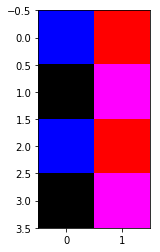

In [145]:
see_output(tmp_patch, figsize=(2,4))

In [216]:
def save_patch_images(img_x1, lbl_x1, index):
    if not os.path.exists('./SD/patched_images/' + str(index)):
        os.makedirs('./SD/patched_images/' + str(index))
        os.makedirs('./SD/patched_images/' + str(index) + "/" + str(lbl_x1))
        

    plt.imsave('./SD/patched_images/' + str(index) + "/" + str(lbl_x1) + '/img.png', np.squeeze(img_x1))
     

In [226]:
def extract_combine_patches(train, labels, img_type_lbl, start_idx):
    patched_images = []
    for index in range(0, len(train)):
#         print(index)
        img_x = train[index:index+1, :]
        lbl_x = labels[index:index+1, :]
        img_type_x = img_type_lbl[index]
        output_cl1 = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4')
        output_fc4_w = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4_W')
        normalized_output = np.rint(normalized(output_cl1))
        np_m = np.squeeze(np.reshape(normalized_output, (1,10,10,1)))
        cornered_image = get_patch_corner(np_m)

        reshaped_img = np.reshape(img_x, (1, 10,10, 3))
        x, y = np.where(cornered_image == 1)
        
        if len(np.where(cornered_image == 1)[0]) > 0:
            tmp_patch = reshaped_img[:, x[0]:x[0] + patch_size[0], y[0]:y[0]+patch_size[1], :]
        else:
            continue
            
        for idx in range(1, len(np.where(cornered_image == 1)[0])):
#             print("index:", idx)
#             print("X:", x)
#             print("Y:", y)
#             print("reshaped image:", reshaped_img)
            tmp_patch1 = reshaped_img[:, x[idx]:x[idx] + patch_size[0], y[idx]:y[idx]+patch_size[1], :]
            tmp_patch = np.expand_dims(np.concatenate((np.squeeze(tmp_patch), np.squeeze(tmp_patch1)), axis=0), axis=0)
        
#         print(tmp_patch.shape)
        save_patch_images(tmp_patch, img_type_x, start_idx + index)
        patched_images.append(tmp_patch)
        tmp_patch = []
        
    return patched_images

In [215]:
len(np.where(cornered_image == 1)[0])

2

In [227]:
train_data, train_labels, img_type = load_data(img_dir)
batch_s = 64
total_iterations = 0
start_ = 0
end_ = batch_s
np.set_printoptions(suppress=True)

if not os.path.exists('./SD/patched_images'):
    os.makedirs('./SD/patched_images')

while True:

    train = train_data[start_:end_]
    labels = train_labels[start_:end_]
    img_type_lbl = img_type[start_:end_]
    
    dims = (batch_s, num_classes, num_channels)
    train, labels, img_type_lbl = get_batch_images(train, labels, img_type_lbl, dims)
    patch_images = extract_combine_patches(train, labels, img_type_lbl, start_)
    
    #do my stuff
    if len(train_data) < start_ + batch_s:
        print("{} Images have been processed.".format(total_iterations))
        break
    
    total_iterations +=batch_s
    start_ = end_
    end_ = end_ + batch_s

INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ValueError: cannot reshape array of size 4800 into shape (64,100,3)

In [176]:
train_data, train_labels, img_type = load_data(img_dir)



train = train_data[0:batch_s]
labels = train_labels[0:batch_s]
img_type_lbl = img_type[0:batch_s]


dims = (batch_s, num_classes, num_channels)
train, labels, img_type_lbl = get_batch_images(train, labels, img_type_lbl, dims)
patch_images = extract_combine_patches(train, labels)

64
0
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
1
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
2
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
3
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
4
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
5
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
6
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
7
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
8
INFO:tensorflow:Restoring parameter

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


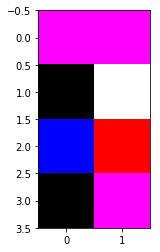

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


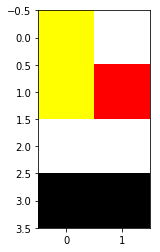

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


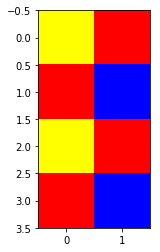

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


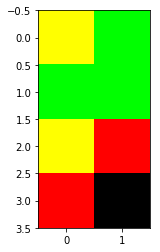

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


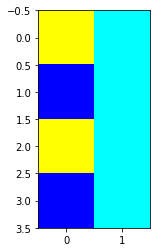

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


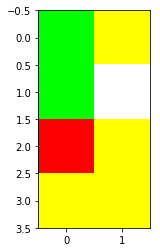

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


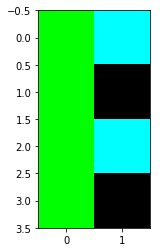

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


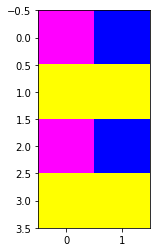

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


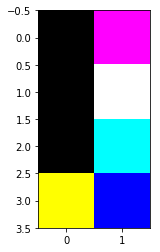

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


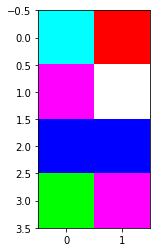

Image Type: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


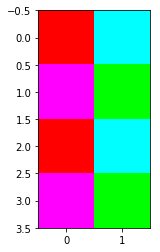

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


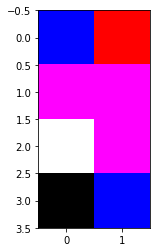

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


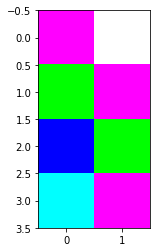

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


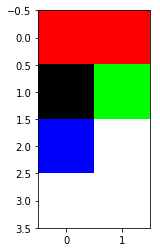

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


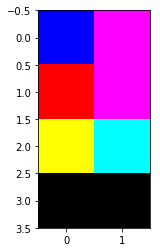

Image Type: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


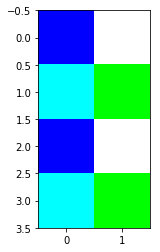

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


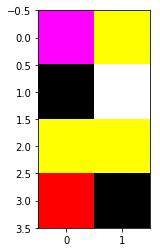

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


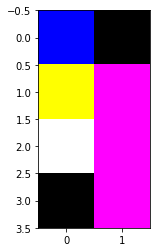

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


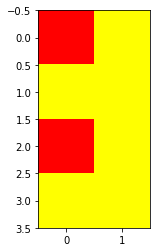

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


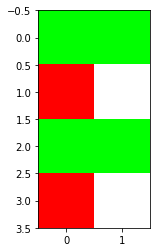

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


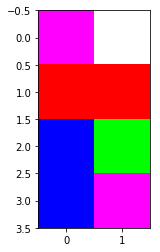

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


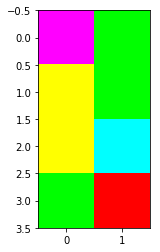

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


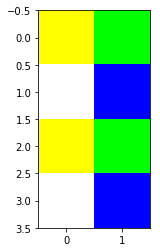

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


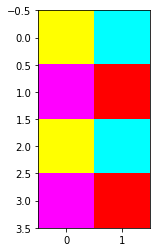

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


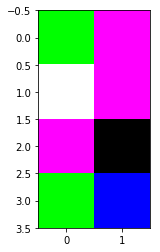

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


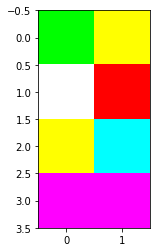

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


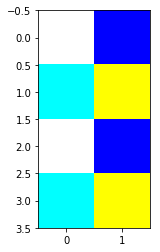

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


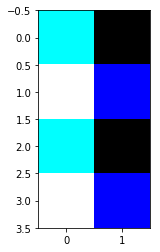

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


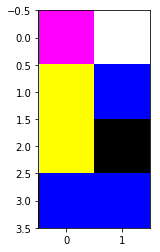

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


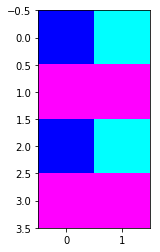

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


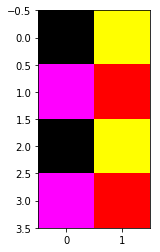

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


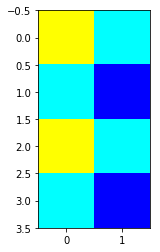

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


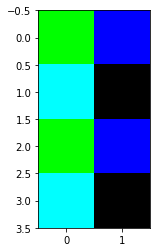

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


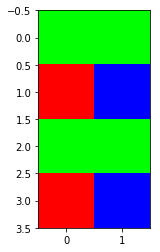

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


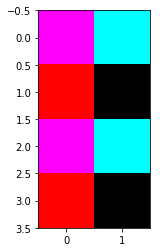

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


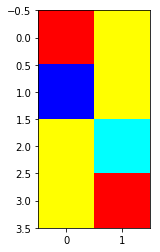

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


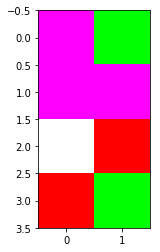

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


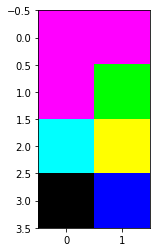

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


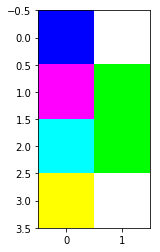

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


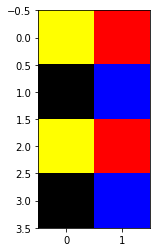

Image Type: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


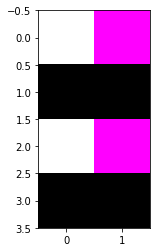

Image Type: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


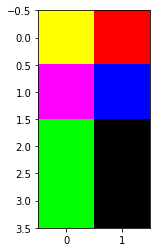

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


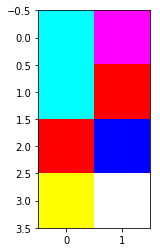

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


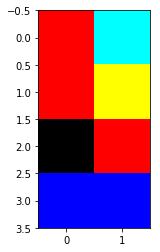

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


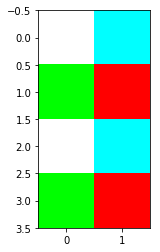

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


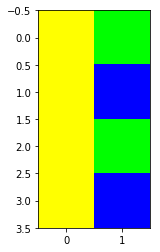

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


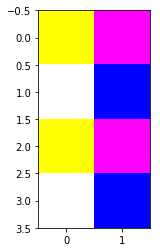

Image Type: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


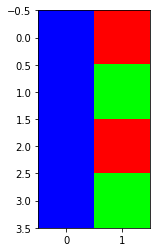

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


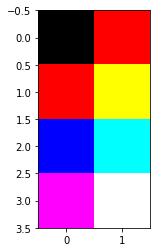

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


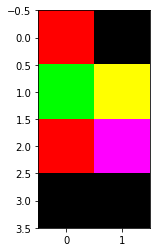

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


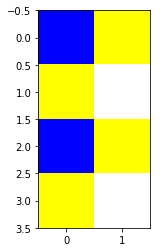

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


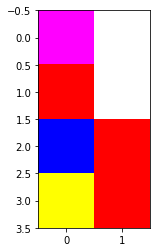

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


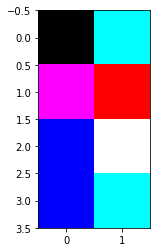

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


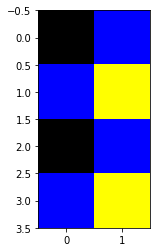

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


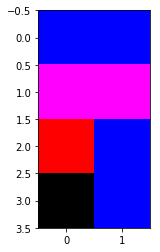

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


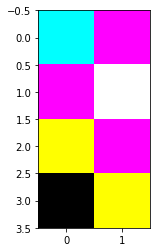

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


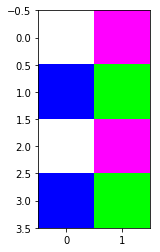

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


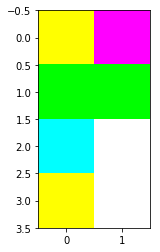

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


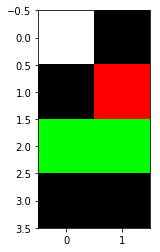

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


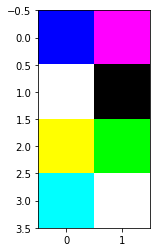

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 1


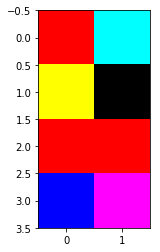

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


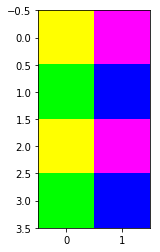

Image Type: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


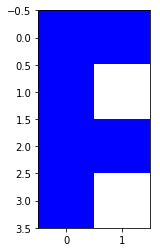

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Type: 0


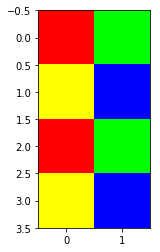

In [177]:
for idx in range(0, len(patch_images)):
    print("Image Type:", img_type_lbl[idx])
    see_output(patch_images[idx], figsize=(2,4))

In [113]:
np.set_printoptions(suppress=True)

img_x = train[0:1, :]
lbl_x = labels[0:1, :]

output_cl1 = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4')
output_fc4_w = restore_see_layer(ix=img_x,model_name=model_50000,var_name='fc_3/fc4_W')

print(output_cl1.shape)
print(output_cl1)
print(lbl_x)
print(output_fc4_w.shape)

INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
INFO:tensorflow:Restoring parameters from SD/sd_50000.ckpt
(1, 100)
[[-11.767122    -4.1772585   24.227077     2.7508435  -17.947367
   13.843363     6.6704826   -5.448791     5.368002     3.835672
   -7.8493533   10.978544    29.302275     7.2533727   10.236395
   13.219638   -15.153336    11.995299   255.53299    228.03926
   -8.727544     5.3923907    0.19590688  -8.785496    14.776383
    1.6496965    0.263222    16.800915   247.90099    231.07332
  -13.272245     3.2576363   11.227653   -18.02335    -11.277952
  -10.739849   -14.146394     8.8959255   21.128292    11.578273
    7.946335    22.11371      8.654033   -15.648542   -12.908142
    2.9263446  -13.004109     2.5652976   12.996049    -8.000272
   -0.30680788   5.9181504   -0.71917605 -14.867792     4.386269
  246.87108    258.29886     17.14315    -23.726702   -17.59881
   -3.0251617    2.5966406   -0.5859602    5.852098    16.630936
  250.88638    252.57199     10

In [124]:
type(output_cl1)

numpy.ndarray

In [114]:
sess2 = tf.Session()
sess2.run(tf.global_variables_initializer())
normalized_output = np.rint(normalise(output_cl1).eval(session=sess2))
np_m = np.squeeze(np.reshape(normalized_output, (1,10, 10,1)))
cornered_image = get_patch_corner(np_m)

In [115]:
reshaped_img = np.reshape(img_x, (1, 10, 10, 3))
x, y = np.where(cornered_image == 1)

reshaped_img1 = reshaped_img[:, x[0]:x[0] + patch_size[0], y[0]:y[0]+patch_size[1], :]
reshaped_img2 = reshaped_img[:, x[1]:x[1] + patch_size[0], y[1]:y[1]+patch_size[1], :]

In [158]:
reshaped_img = np.reshape(img_x, (1, 10,10, 3))
tmp_patch = reshaped_img[:, x[0]:x[0] + patch_size[0], y[0]:y[0]+patch_size[1], :]

TypeError: 'int' object is not subscriptable

In [117]:
concat_img = np.expand_dims(np.concatenate((np.squeeze(reshaped_img1), np.squeeze(reshaped_img2)), axis=0), axis=0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


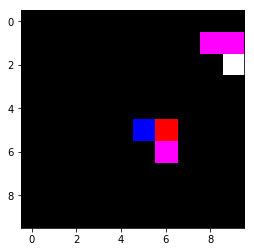

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


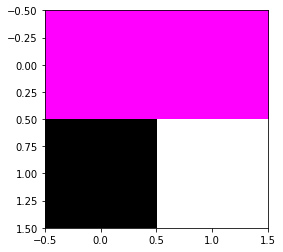

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


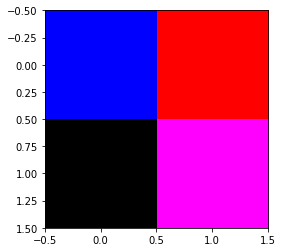

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


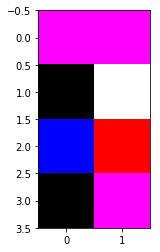

In [118]:
original_image = np.reshape(img_x, (1, 10, 10, 3))
# predicted_image = np.reshape(output_cl1, (1, 4, 4, 3))
# visual_image = np.reshape(patch.eval(session=sess2), (1, 2, 4, 3))
# visual_label = np.reshape(lbl_x, (1, 4, 4, 3))

# visual_image_conn = np.reshape(output_fully_connected, (1, 120, 120, 3))
# visual_label_conn = np.reshape(lbl_x, (1, 120, 120, 3))
see_output(original_image)
# see_output(visual_label)
# see_output(predicted_image)
# see_output(visual_image)
# reshaped_img = reshaped_img[:, x[0]:x[0] + 2, y[0]:y[0]+2, :]
see_output(reshaped_img1)
see_output(reshaped_img2)
see_output(concat_img, figsize=(2,4))
# see_output(reshaped_img3)
# see_output(reshaped_img4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


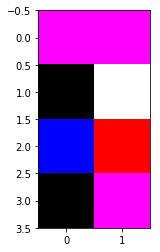

In [122]:
see_output(concat_img, figsize=(2,4))